<a href="https://colab.research.google.com/github/chaggerty93/Gaza-Solidarity-Encampments-Mapping/blob/main/University_Encampments.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Install Packages

In [ ]:
import folium
from folium import IFrame
import geopandas
import gspread
import gspread_dataframe as gdf
from oauth2client.client import GoogleCredentials
from google.colab import drive, auth
import pandas as pd
import base64
import re
import os
from google.auth import default

drive.mount('/content/drive', force_remount=True)


Mounted at /content/drive


# Import Encampment Data


In [ ]:
auth.authenticate_user()

creds, _ = default()

gc = gspread.authorize(creds)

worksheet = gc.open('Encampments').sheet1

# get_all_values gives a list of rows.
rows = worksheet.get_all_records()

# Convert to a DataFrame and render.
encampment_data = pd.DataFrame(rows)
encampment_data = encampment_data.convert_dtypes()
encampment_data.dtypes

encampment_data['Latitude'] = pd.to_numeric(encampment_data['Latitude'], errors='coerce')
encampment_data['Longitude'] = pd.to_numeric(encampment_data['Longitude'], errors='coerce')
encampment_data['Encampment Start Date'] = pd.to_datetime(encampment_data['Encampment Start Date'], errors='coerce')
encampment_data['Date of raid/arrests'] = pd.to_datetime(encampment_data['Date of raid/arrests'], errors='coerce')
encampment_data['Location'] = encampment_data['City'].str.strip() + ", " + encampment_data['State'].str.strip()
encampment_data

,University Name,City,State,Country,Latitude,Longitude,Category,Status,Encampment Start Date,Police/State Violence,Image Source,Date of raid/arrests,Number of Arrests,Source,Location
0,Columbia University,New York,New York,U.S.,40.807384,-73.963036,Encampment,Encampment Ongoing,2024-04-17,Mass arrests,PYM NYC,2024-04-18,,https://www.instagram.com/reel/C53zTS0uLxg/?ut...,"New York, New York"
1,The New School,New York,New York,U.S.,40.734677,-73.991509,Encampment,Encampment Ongoing,2024-04-21,,TNS SJP,NaT,,https://www.instagram.com/reel/C6JjZykLzGB/?ut...,"New York, New York"
2,NYU,New York,New York,U.S.,40.729675,-73.996925,Encampment,"Encampment Dispersed, Solidarity Actions Continue",2024-04-22,"Mass arrests, encampment cleared",,NaT,,https://www.instagram.com/p/C6DrwzRuxhV/?utm_s...,"New York, New York"
3,Yale,New Haven,Connecticut,U.S.,41.316307,-72.922585,Encampment,Encampment Dispersed,2024-04-20,Mass arrests,https://www.instagram.com/yalies4palestine?igs...,NaT,,https://www.instagram.com/p/C6EF_mnL9k0/,"New Haven, Connecticut"
4,University of Minnesotta,Twin Cities,Minnesotta,U.S.,44.974,-93.2277,Encampment,"Encampment Dispersed, Solidarity Actions Continue",NaT,Mass arrests,,NaT,,https://www.motherjones.com/politics/2024/04/g...,"Twin Cities, Minnesotta"
5,Brown University,Providence,Rhode Island,U.S.,41.8268,-71.4025,Encampment,Encampment Ongoing,2024-04-24,,,NaT,,https://www.motherjones.com/politics/2024/04/g...,"Providence, Rhode Island"
6,Cal Poly Humboldt,Arcata,California,U.S.,40.8747,-124.0789,Encampment,Encampment Ongoing,2024-04-23,Police Raid,,NaT,,https://www.motherjones.com/politics/2024/04/g...,"Arcata, California"
7,University of North Carolina,Chapell Hill,North Carolina,U.S.,35.9049,-79.0469,Encampment,"Encampment Dispersed, Solidarity Actions Continue",2024-04-19,,,NaT,,https://x.com/MiddleEastEye/status/17826392806...,"Chapell Hill, North Carolina"
8,Universtiy of Michigan,Ann Arbor,Michigan,U.S.,42.2771,-83.7382,Encampment,Encampment Ongoing,2024-04-24,,,NaT,,https://www.motherjones.com/politics/2024/04/g...,"Ann Arbor, Michigan"
9,Swarthmore College,Swarthmore,Pennsylvania,U.S.,39.9038,-75.3527,Encampment,Encampment Ongoing,2024-04-23,,,NaT,,https://www.swarthmore.edu/presidents-office/p...,"Swarthmore, Pennsylvania"


# Media Preparation - Encampment Images

In [ ]:
directory_path = '/content/drive/MyDrive/Colab Notebooks/Gaza Solidarity Encampments/Media'
directory_files = os.listdir(directory_path)
directory_files

# df = pd.Dataframe()
# for file in directory_files:
#     df_file = pd.read_csv(os.path.join(directory_path, file), encoding = 'ISO-8859-1',low_memory=False)
#     df = pd.concat([df, df_file])

['Berkley',
 'Columbia',
 'New School',
 'NYU',
 'Yale',
 'UNC - Charlotte',
 'Tufts',
 'Vanderbilt',
 'Brown',
 'Minnesota, University of ',
 'Cal Poly Humbolt',
 'UNC - Chapel Hill',
 'Swarthmore',
 'Michigan, University of ',
 'MIT',
 'Rochester, University of',
 'Pittsburgh, University of ',
 'University of New Mexico',
 'Maryland, University of',
 'UT Austin',
 'Harvard University',
 'Emerson College',
 'Rice University',
 'University of Southern California']

In [ ]:
for imageName in df['JPGs']:
    frames=[]
    imageName = imageName.split(',')
    for i in imageName:
        frames.append('F:/Jupyter Notebooks/Medium articles/Interactive maps/' + str(i)+'.jpeg')
    with imageio.get_writer('F:/Jupyter Notebooks/Medium articles/Interactive maps/' + str(i[:-1]) + '.gif', mode='I', duration=2) as writer:
        for filename in frames:
            image = cv2.resize(imageio.imread(filename), (width, height))
            writer.append_data(image)

# University Encampments

In [ ]:
# Define USA coordinates
usa_coord = [37.0902, -95.7129] # Latitude, Longitude coord in decimal degrees
nyc_coord = [40.7128, -74.0060]
# Create USA map with folium wrapper around leaflet.js

usa_map = folium.Map(location=usa_coord, zoom_start=4.4)
folium.TileLayer('cartodbpositron').add_to(usa_map)

# Encampment Markers
## Map Icon
pal_flag = "/content/drive/My Drive/673813_map_map marker_national_country_palestinian_pin_flag_palestine.png"
icon = folium.CustomIcon(pal_flag, icon_size=(60, 60))  # Adjust icon size as needed , icon_size=(50, 50)

## School Markers
### Columbia University
#### Encampment Photo
# Path to the shared folder and image within it
shared_folder_path = '/content/drive/My Drive/Colab Notebooks/Gaza Solidarity Encampments/Media'
image_path = f'{shared_folder_path}/Columbia/columbia_encampment_temp.avif'

# # Encode your image to base64
# with open(image_path, "rb") as img_file:
#     encoded_image = base64.b64encode(img_file.read()).decode('utf-8')

# # Add a marker with a popup containing an image
# popup_html = f"""
#     <h4>Columbia University Encampment</h4>
#     <img src="data:image/jpeg;base64,{encoded_image}" alt="Image" style="width:250px;height:200px;">
# """
# popup = folium.Popup(folium.IFrame(html=popup_html, width=250, height=250))

# folium.Marker(
#     location=[40.807384, -73.963036],
#     tooltip="Click me!",
#     popup=popup,
#     icon=icon,
# ).add_to(usa_map)


# for i in range(0,len(encampment_data)):

#   icon = folium.CustomIcon(pal_flag, icon_size=(60, 60))  # Adjust icon size as needed , icon_size=(50, 50)

#   folium.Marker(
#       location=[encampment_data.iloc[i]['Latitude'], encampment_data.iloc[i]['Longitude']],
#       popup=encampment_data.iloc[i]['University Name'],
#       icon=icon
#    ).add_to(usa_map)

# usa_map


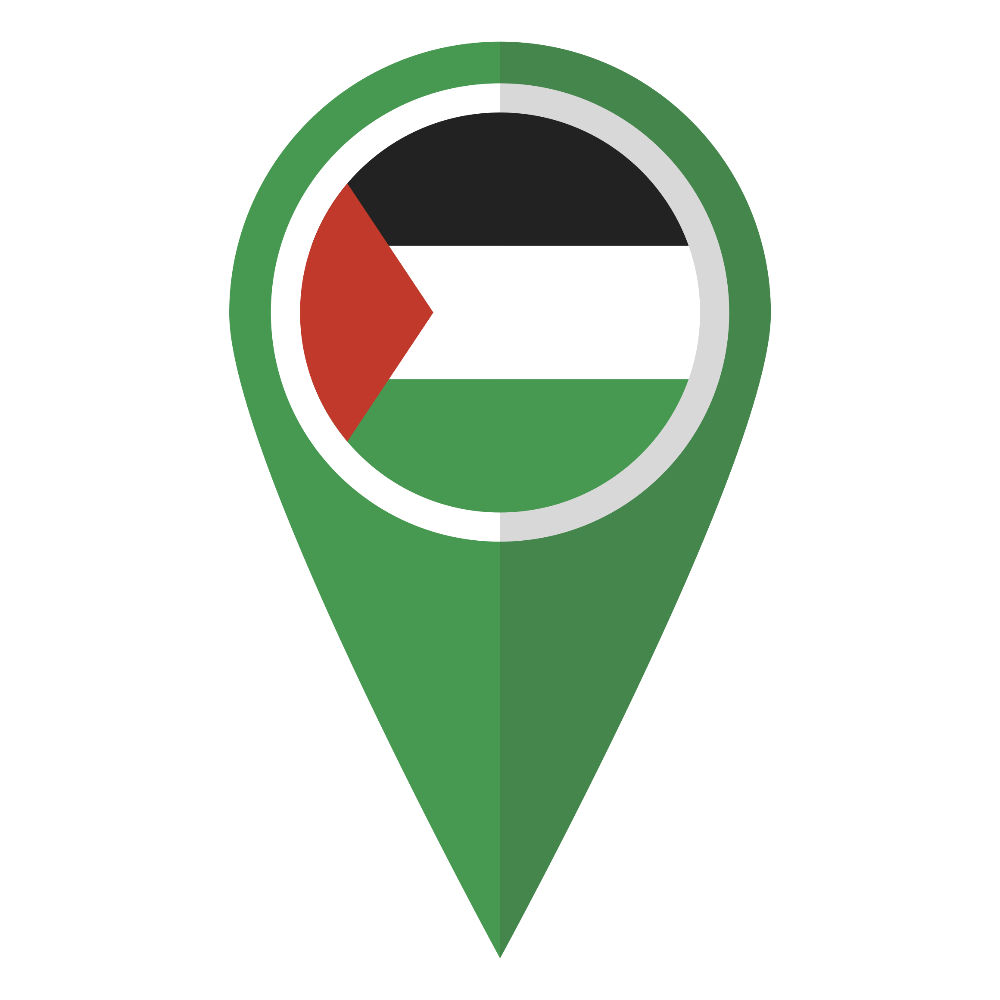
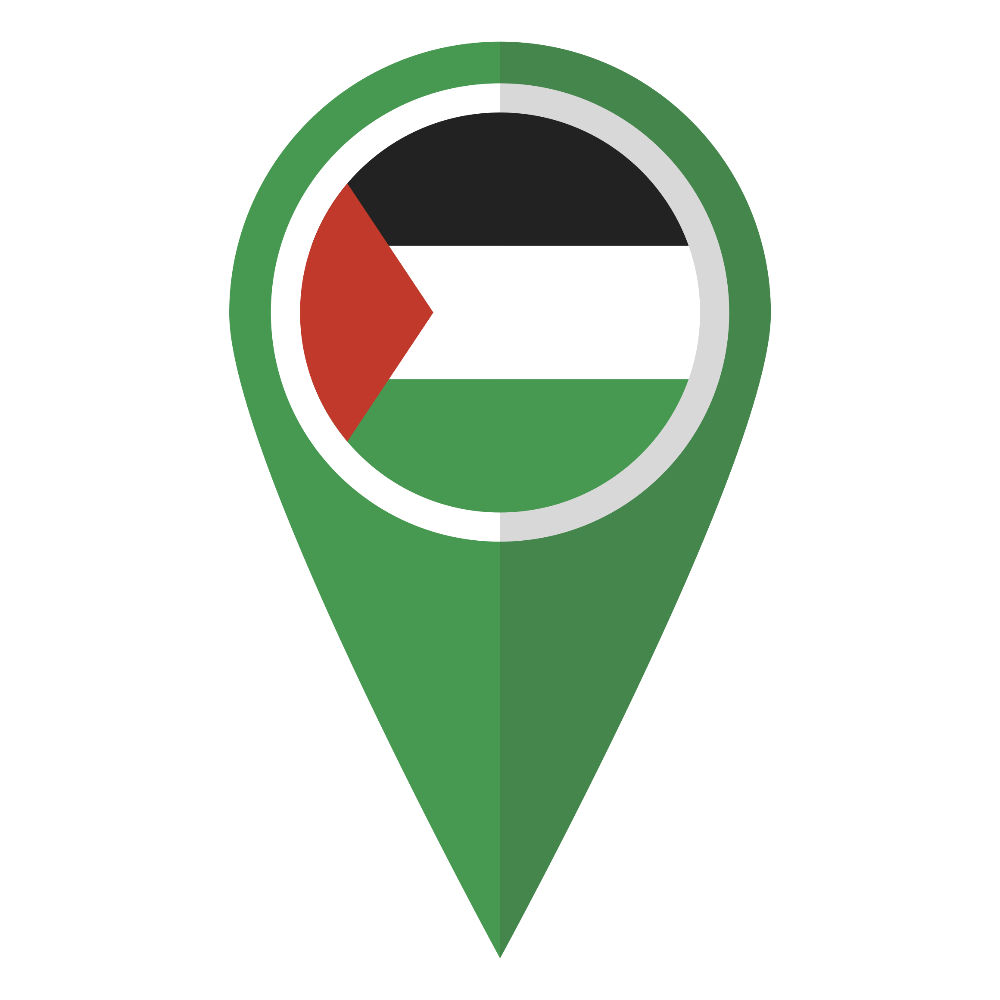
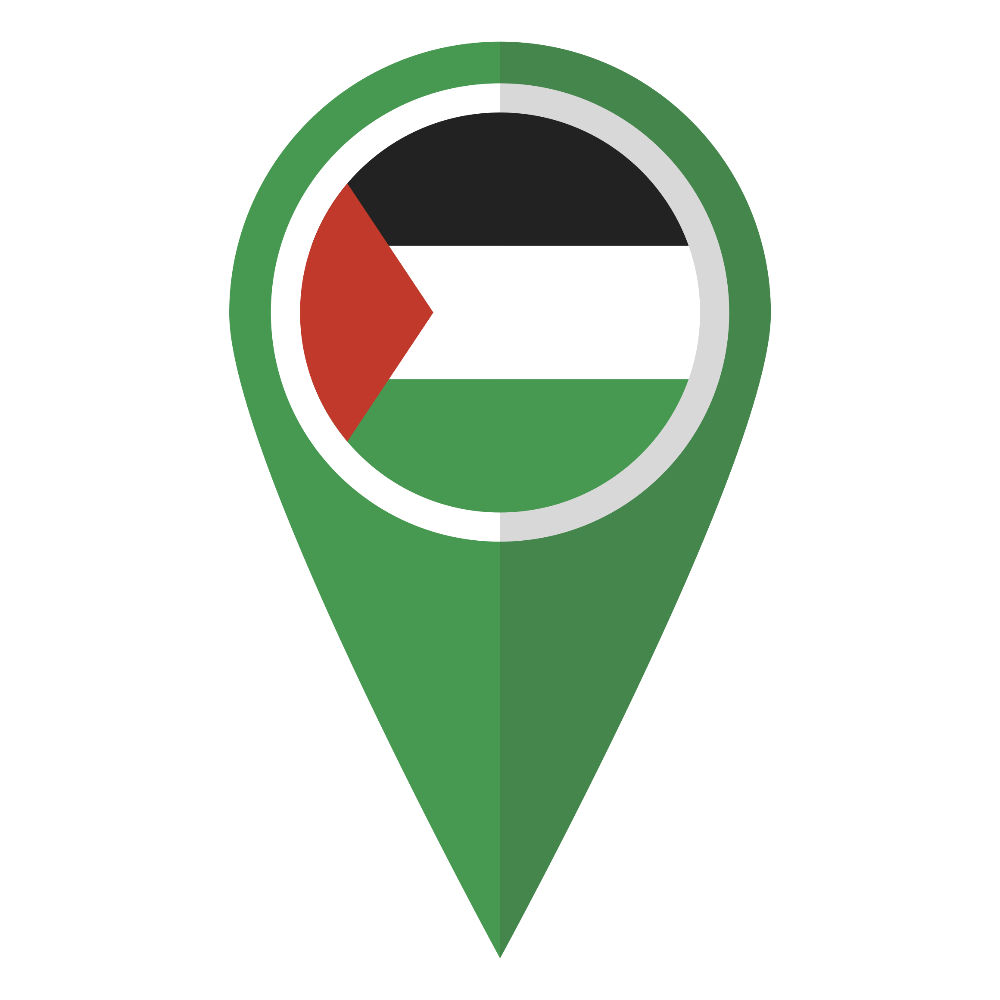
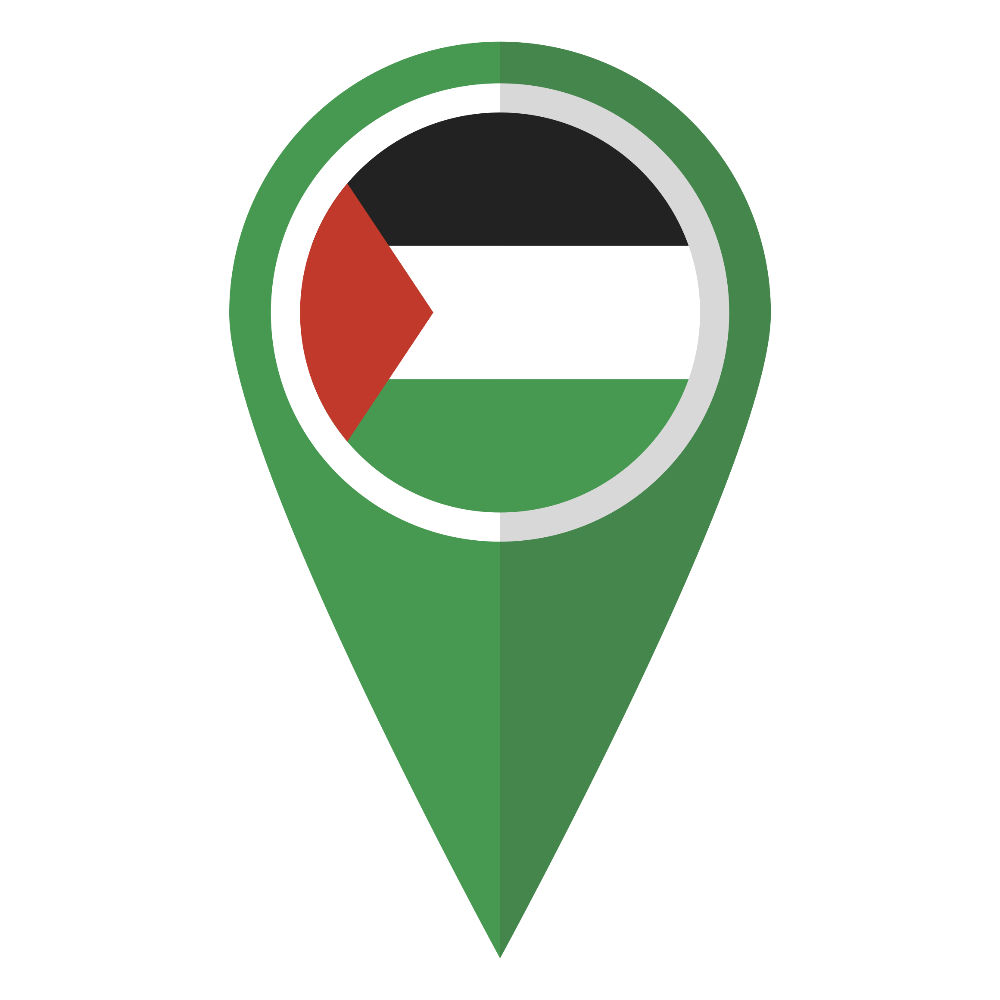
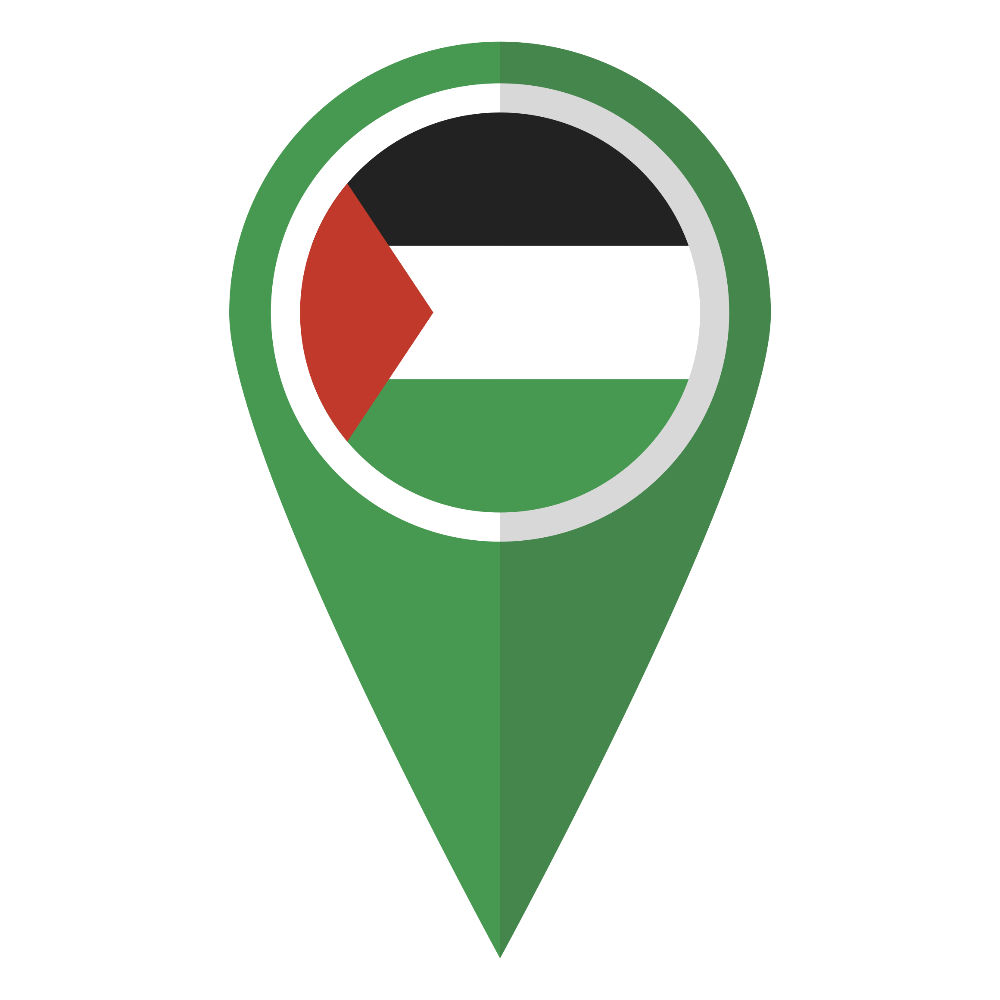
...
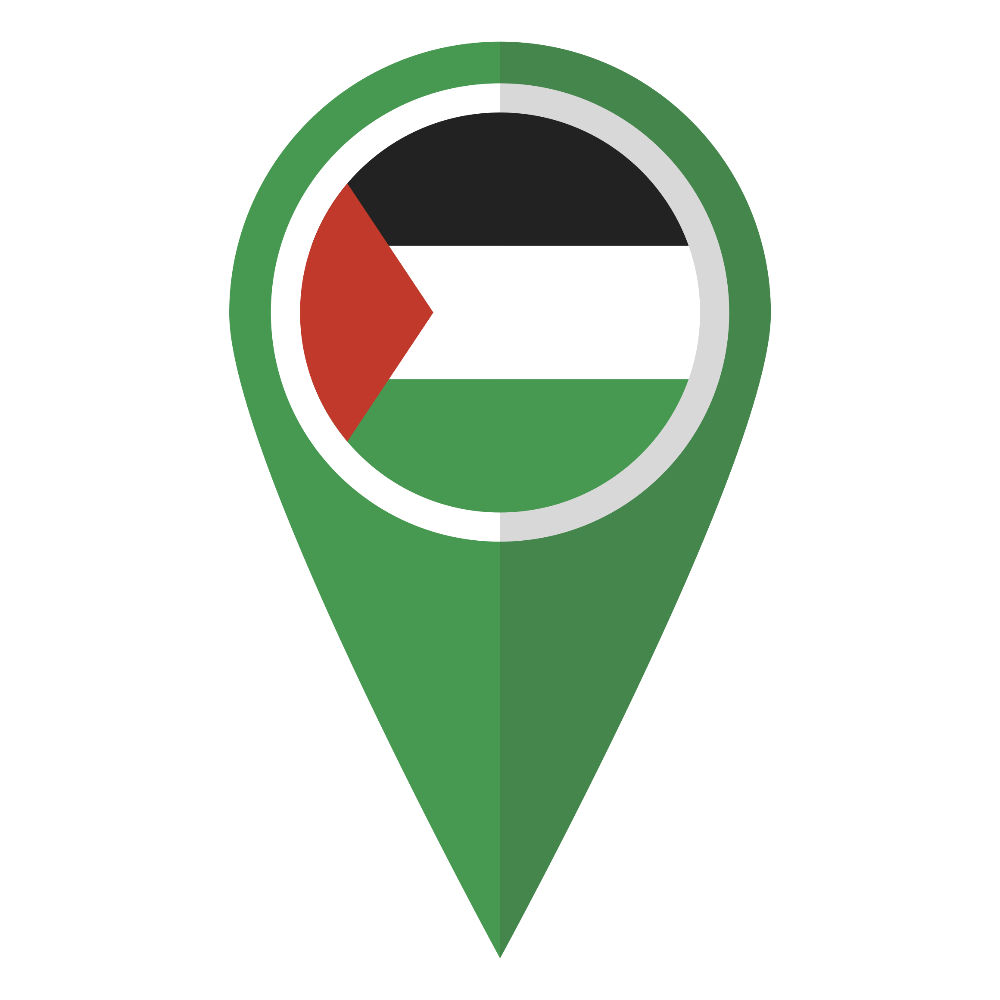
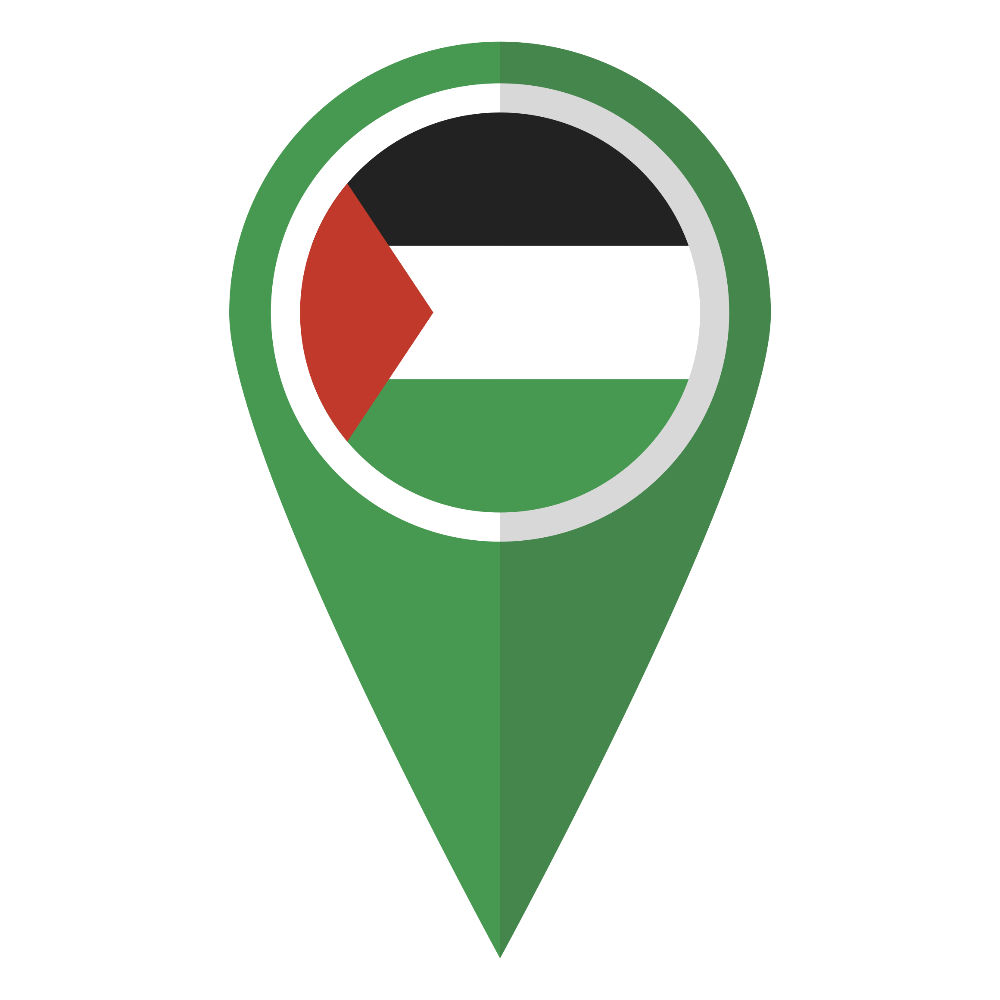
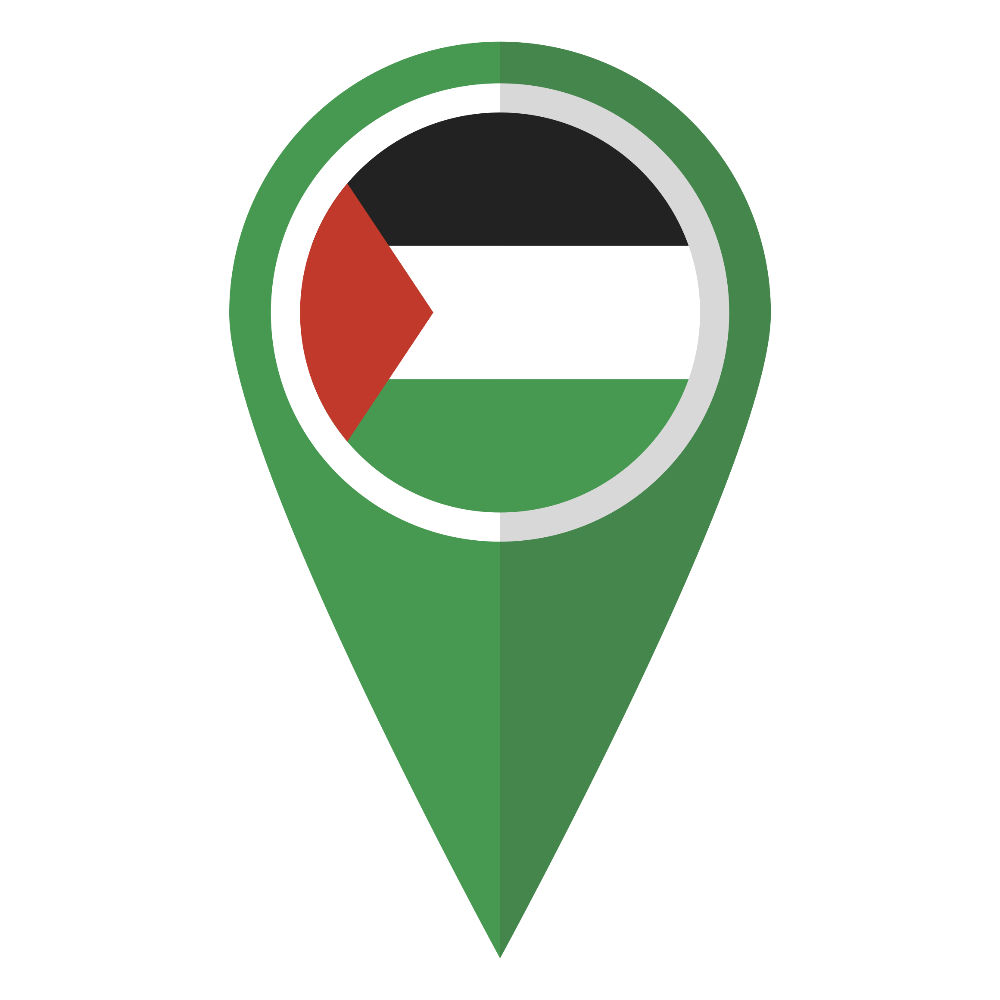
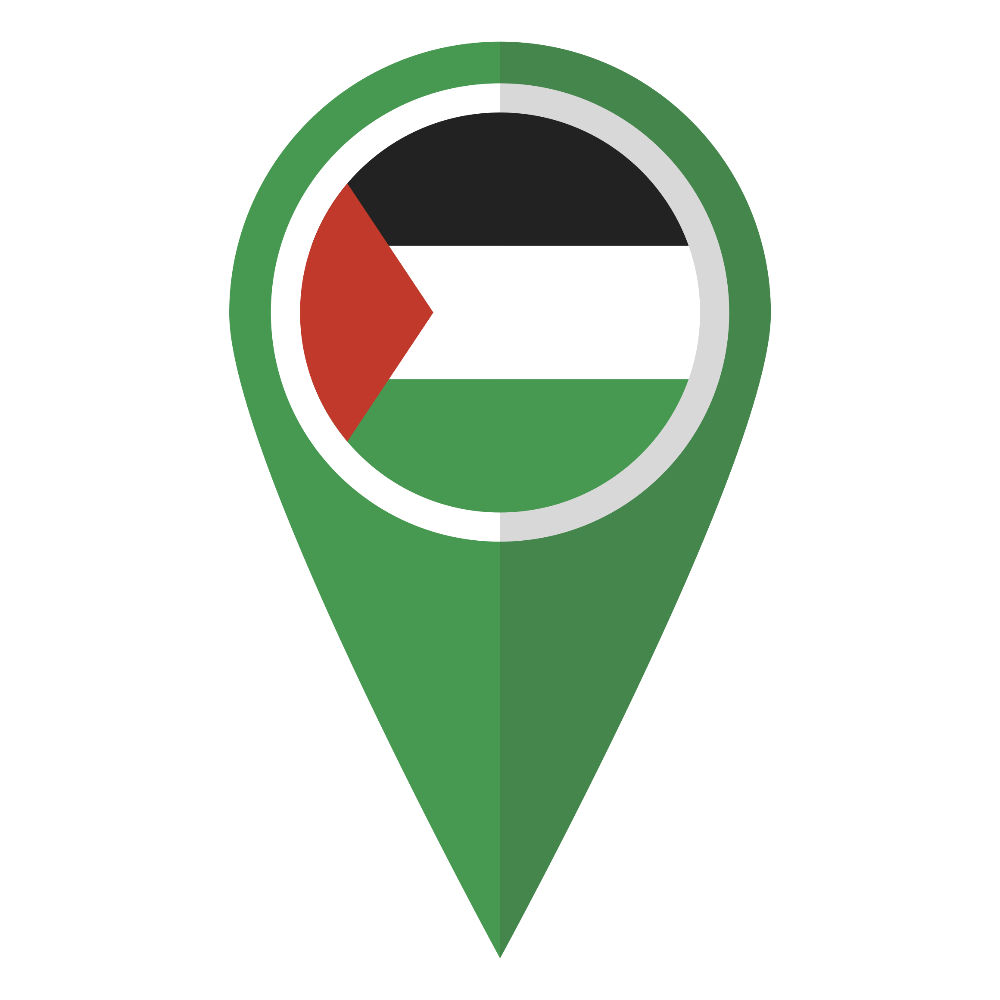
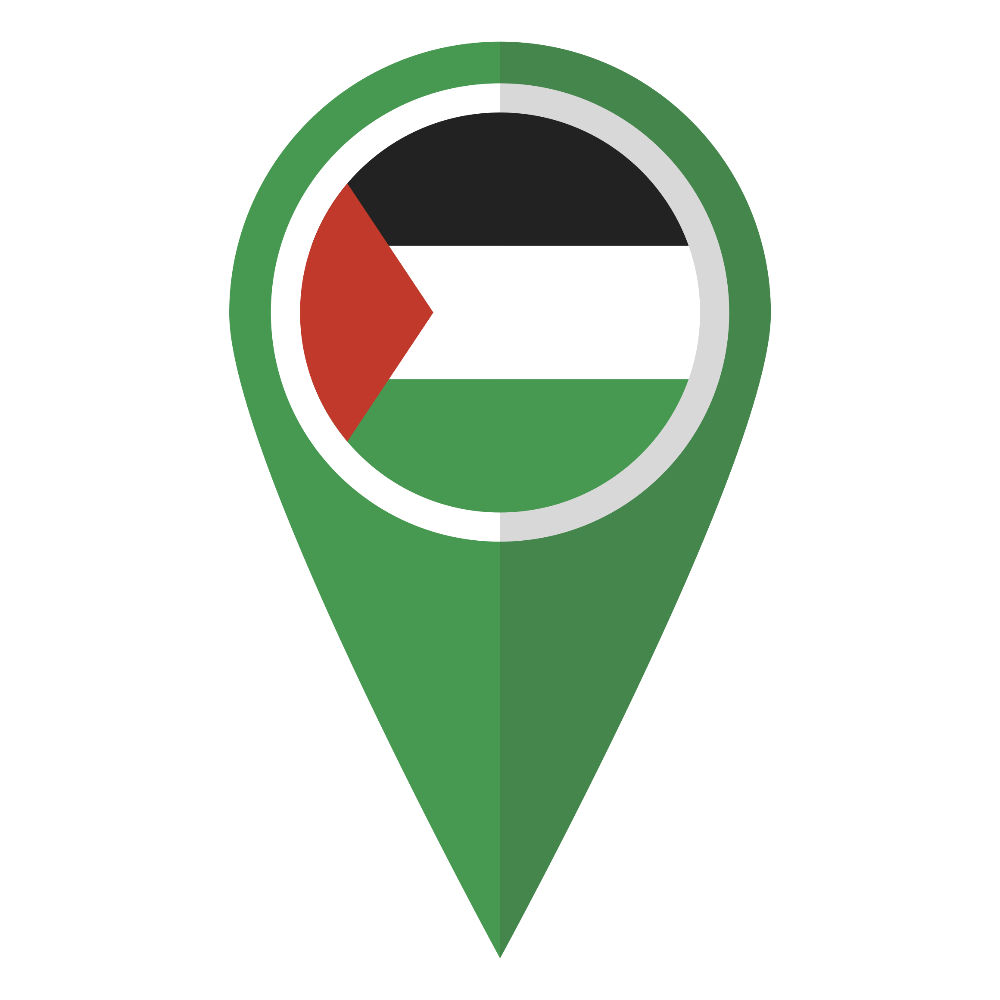

In [165]:
for index, row in encampment_data.iterrows():
        # Write the html code for the popups
    html = folium.Html(
            f"""
            <!DOCTYPE html>
            <html>
            <h1 align="center" style="font-family:Calibri; color:red"><strong><u>{row['University Name']}</u><strong>
            <link rel="stylesheet" href="https://cdnjs.cloudflare.com/ajax/libs/font-awesome/4.7.0/css/font-awesome.min.css">
            <link href="https://maxcdn.bootstrapcdn.com/bootstrap/3.3.7/css/bootstrap.min.css" rel="stylesheet"/>
            </h1>
            <!-- <p class="narrow" style="text-align: left;"> -->
            <div class="panel-group" id="accordion" role="tablist" aria-multiselectable="true">

                <div class="panel panel-default" style="text-align: left !important; border-color: #ffffff!important;">
                    <div class="panel-heading" role="tab" id="headingOne" style="background: #ffffff!important;">
                        <h4 class="panel-title" style="color:green">
                            <a class="collapsed" role="button" data-toggle="collapse" data-parent="#accordion" href="#collapseOne" aria-expanded="false" aria-controls="collapseOne">
                                <strong><i class="fa fa-map-marker"></i> Location <span class="glyphicon glyphicon-menu-down" aria-hidden="true" style="float: right;"></span> </strong>
                            </a>
                        </h4>
                    </div>
                    <div id="collapseTwo" class="panel-collapse collapse" role="tabpanel" aria-labelledby="headingOne">
                        <div class="panel-body" align="justify">
                        {row['Location']}
                        </div>
                    </div>
                </div>

                <div class="panel panel-default" style="text-align: left !important; border-color: #ffffff!important;">
                    <div class="panel-heading" role="tab" id="headingTwo" style="background: #ffffff!important;">
                        <h4 class="panel-title" style="color:green">
                            <a class="collapsed" role="button" data-toggle="collapse" data-parent="#accordion" href="#collapseTwo" aria-expanded="false" aria-controls="collapseTwo">
                                <strong><i class="fa-solid fa-tents"></i> Encampment Start Date <span class="glyphicon glyphicon-menu-down" aria-hidden="true" style="float: right;"></span> </strong>
                            </a>
                        </h4>
                    </div>
                    <div id="collapseThree" class="panel-collapse collapse" role="tabpanel" aria-labelledby="headingTwo">
                        <div class="panel-body" align="justify">
                        {row['Encampment Start Date']}
                    </div>
                </div>

                <div class="panel panel-default" style="text-align: left !important; border-color: #ffffff!important;">
                    <div class="panel-heading" role="tab" id="headingThree" style="background: #ffffff!important;">
                        <h4 class="panel-title" style="color:green">
                            <a class="collapsed" role="button" data-toggle="collapse" data-parent="#accordion" href="#collapseThree" aria-expanded="false" aria-controls="collapseThree">
                                <strong><i class="fa-solid fa-handcuffs"></i> Police/State Violence <span class="glyphicon glyphicon-menu-down" aria-hidden="true" style="float: right;"></span> </strong>
                            </a>
                        </h4>
                    </div>
                    <div id="collapseFour" class="panel-collapse collapse" role="tabpanel" aria-labelledby="headingThree">
                        <div class="panel-body" align="justify">
                        {row['Police/State Violence']}
                        </div>
                    </div>
                </div>
            </div>

</html>
            """,
            script=True)
        # Create the popup
    icon = folium.CustomIcon(pal_flag, icon_size=(60, 60))  # Adjust icon size as needed , icon_size=(50, 50)
    popup  = folium.Popup(html, max_width=500)
    folium.vector_layers.Marker(location=[row['Latitude'],row['Longitude']],
                                popup = popup,
                                icon = icon,
                                tooltip=str(row['University Name'])).add_to(usa_map)
            # <center>
            #     <img src="{row['University Name']}.gif" width="400" style="border-radius: 50px;"/>
            # </center>
usa_map

# Other Popup Testing


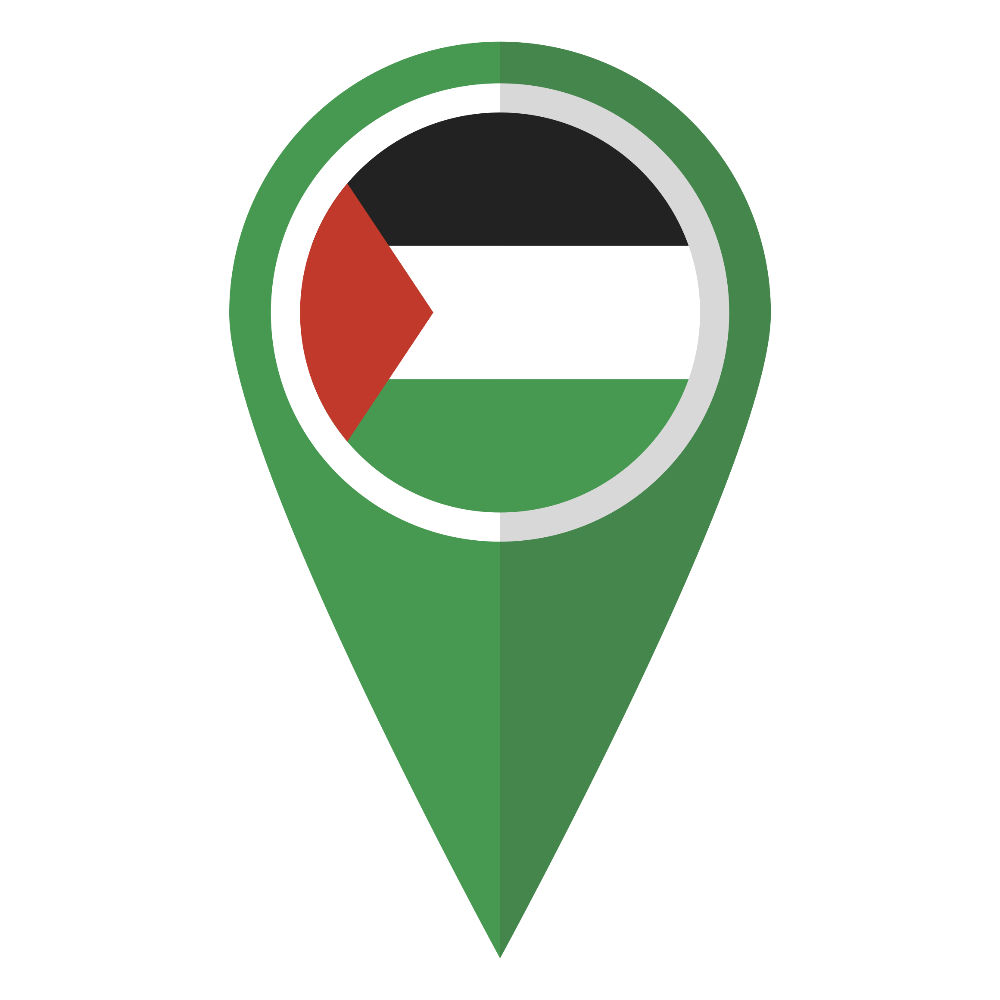
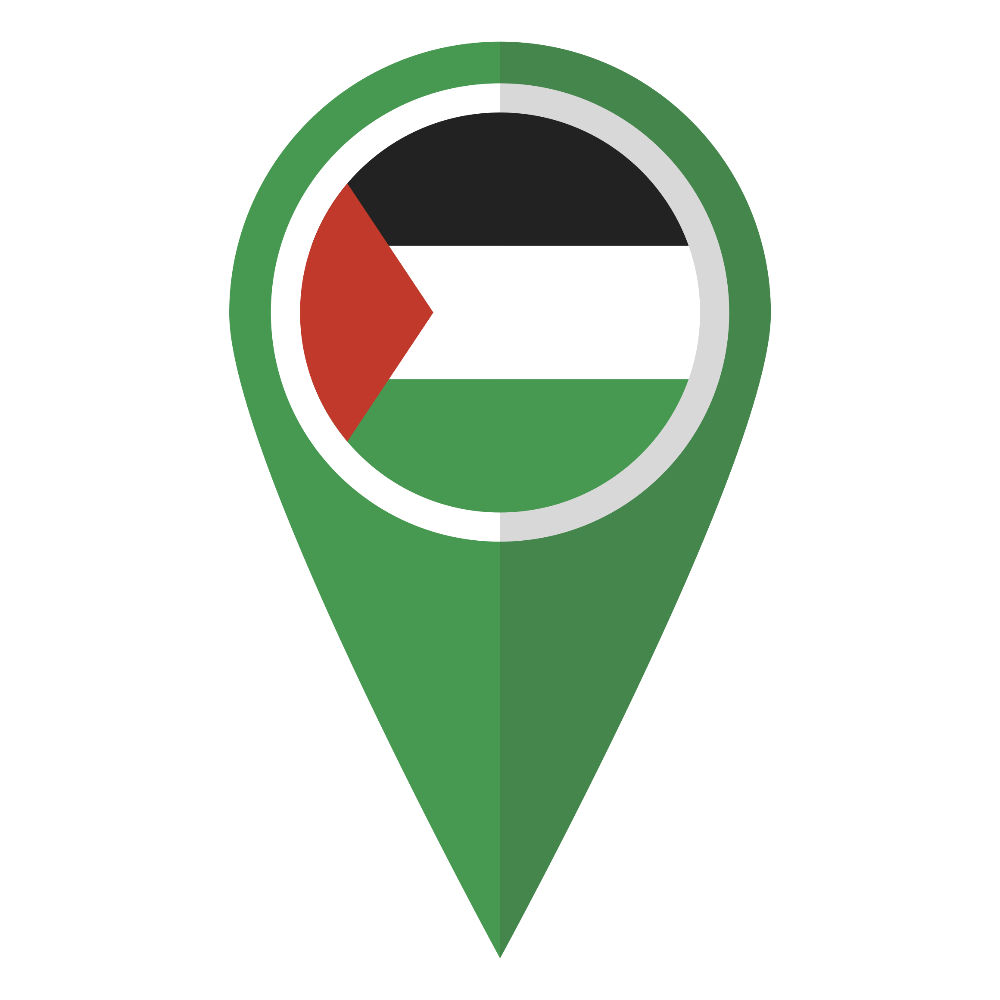
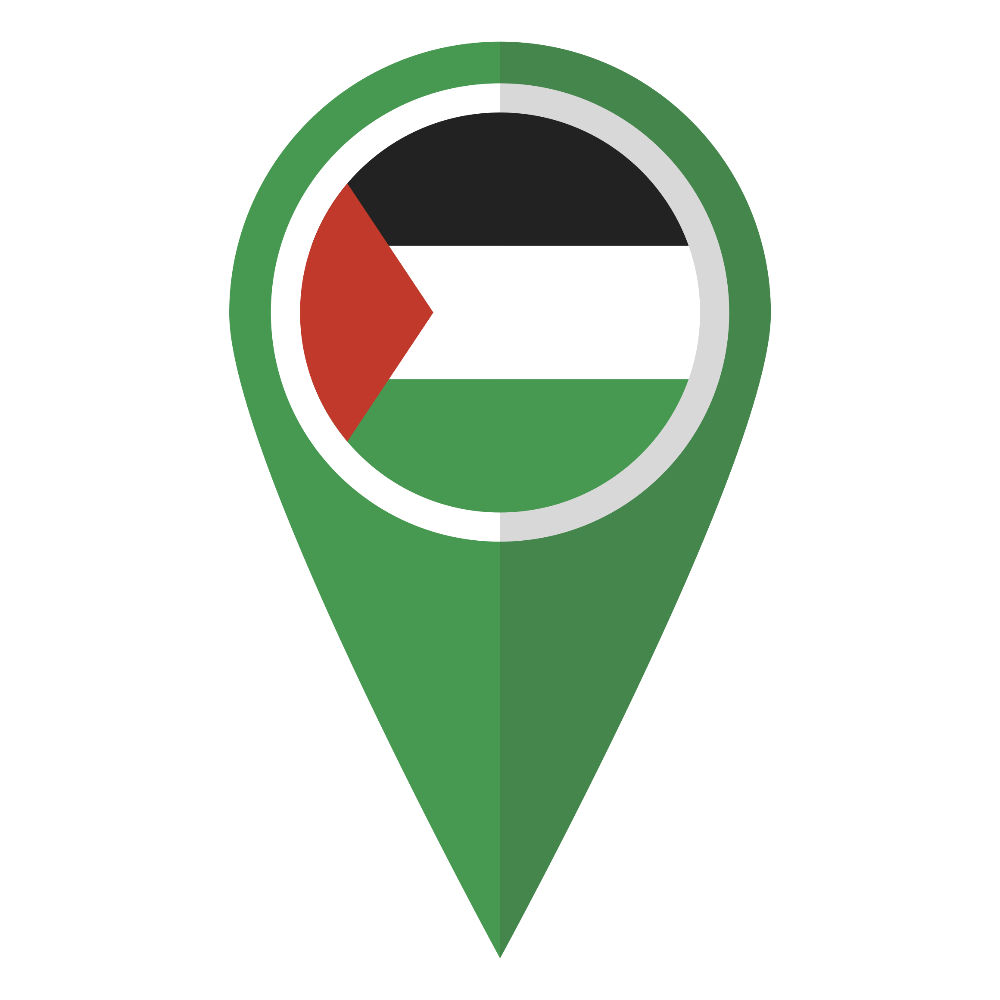
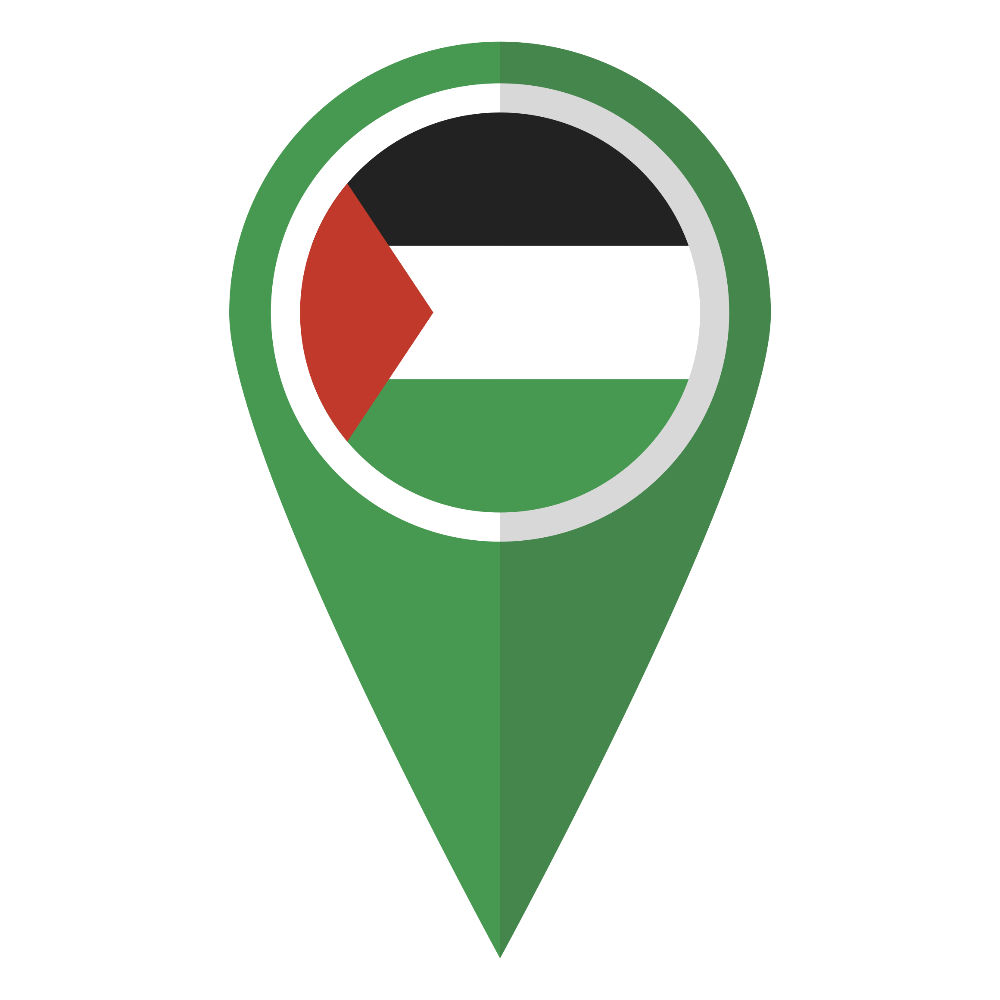
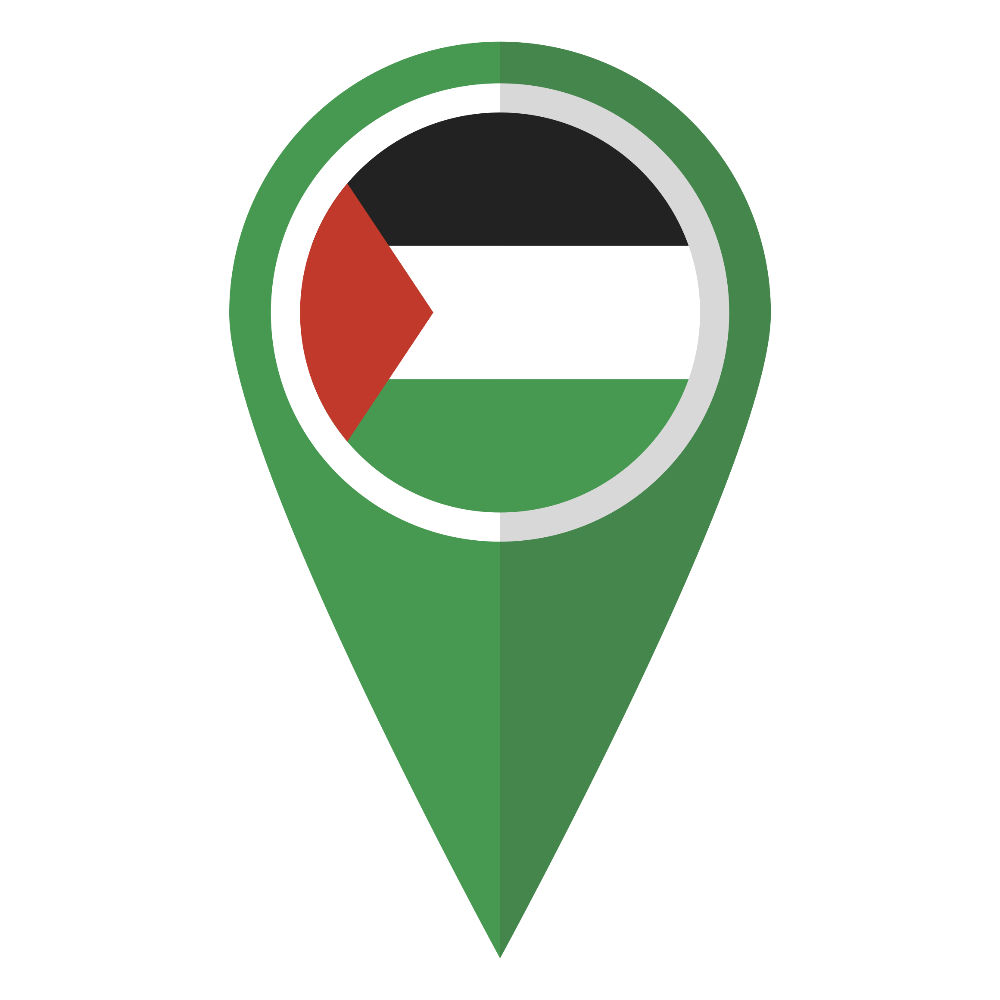
...
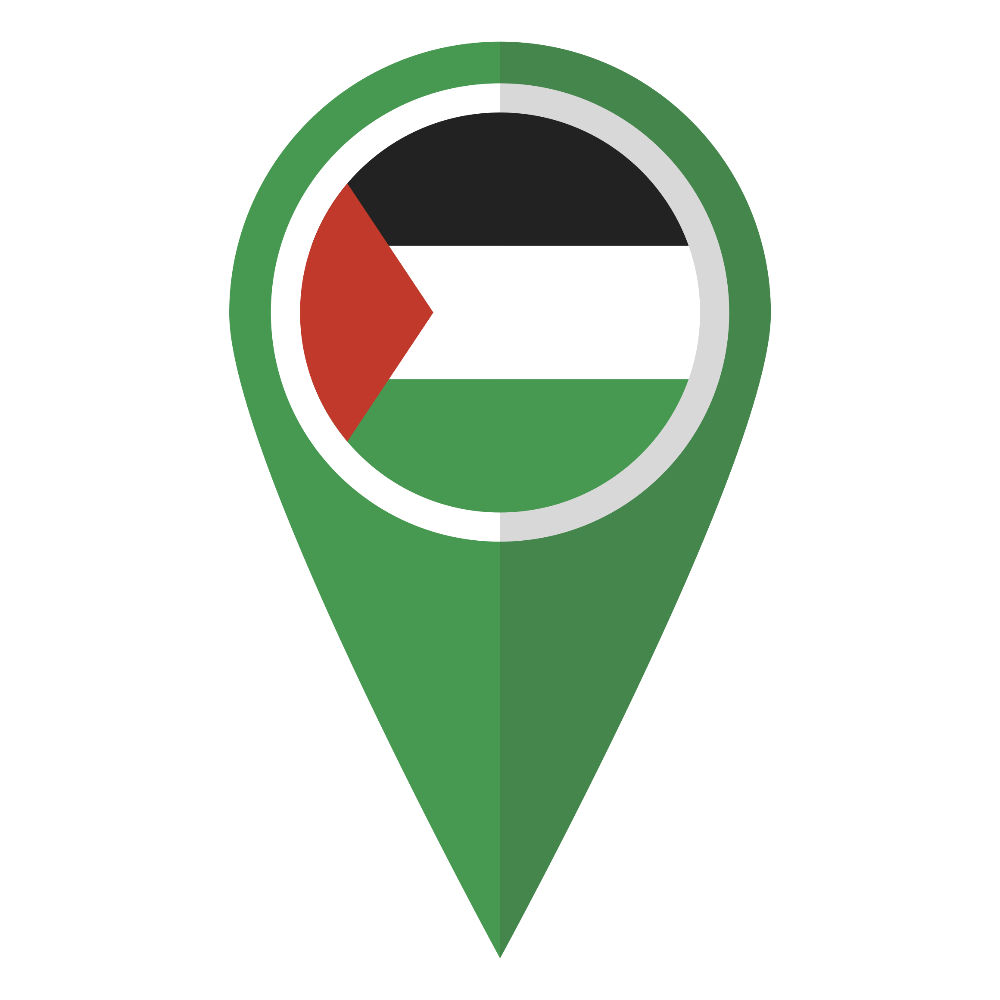
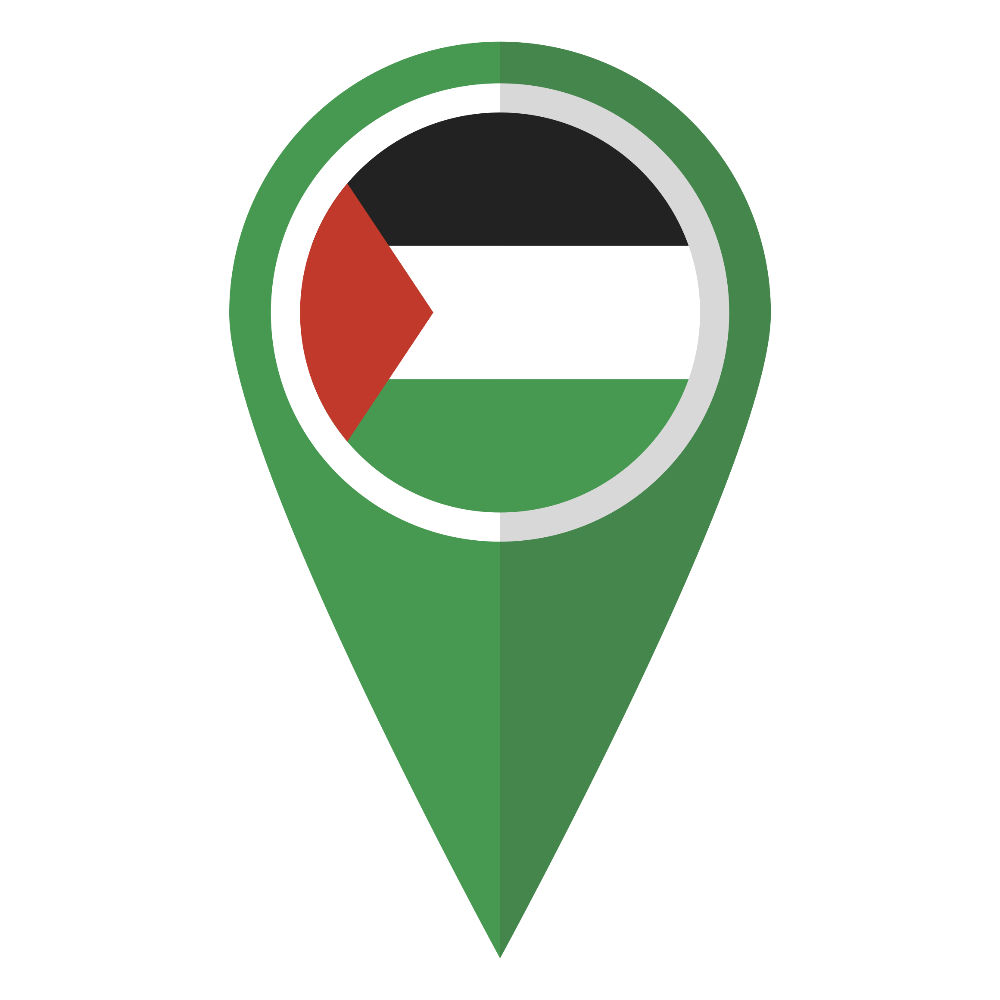
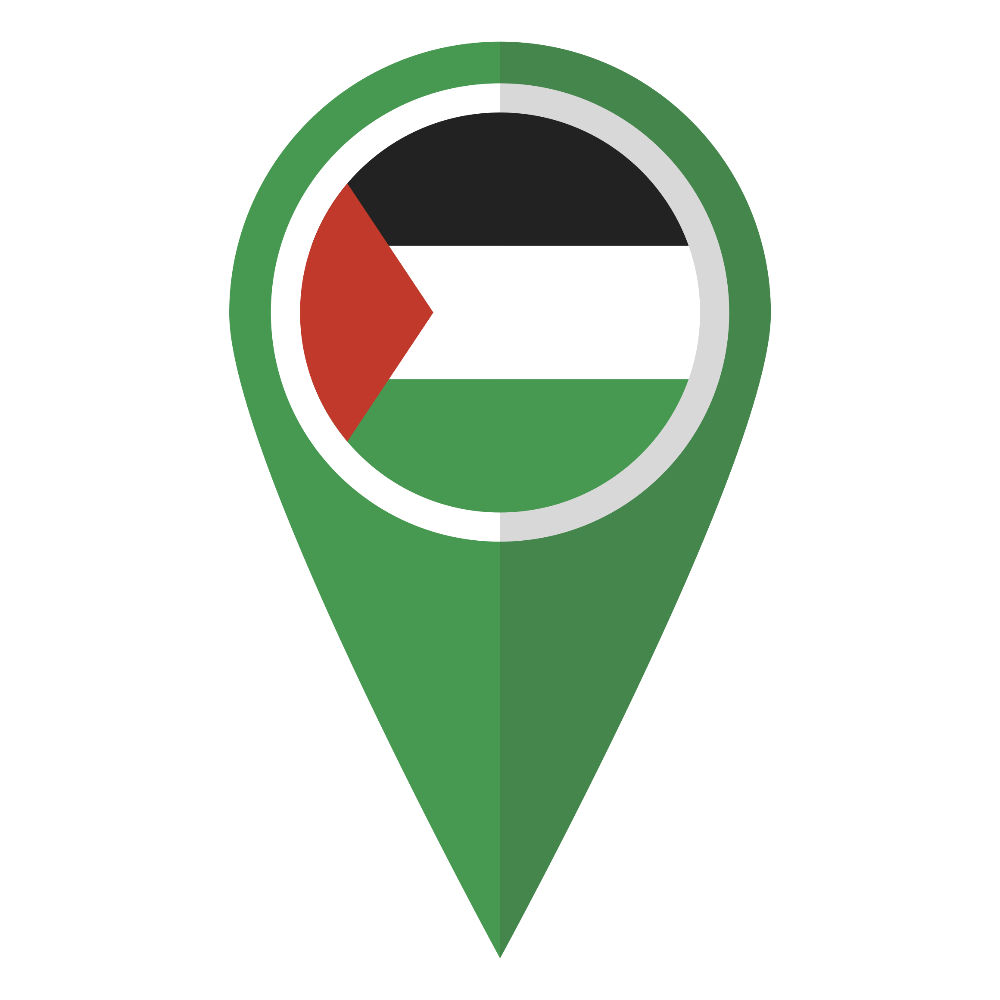
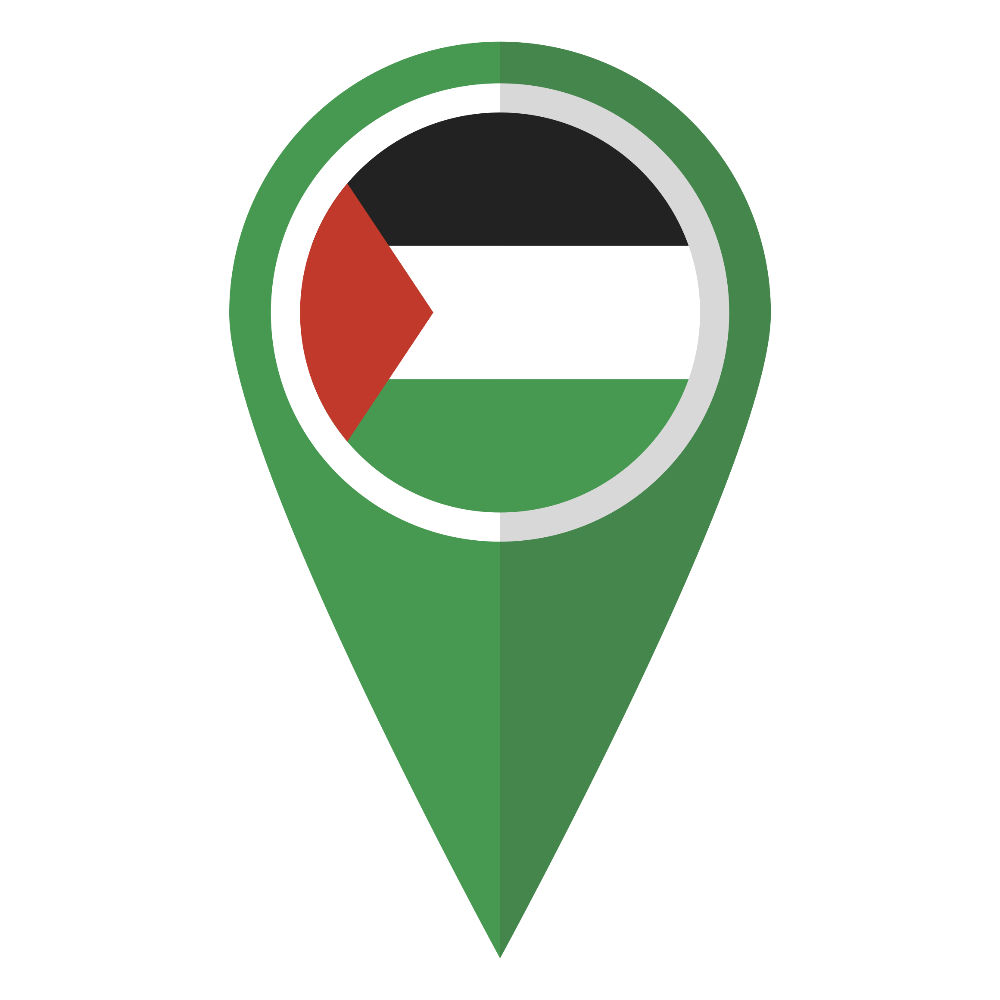
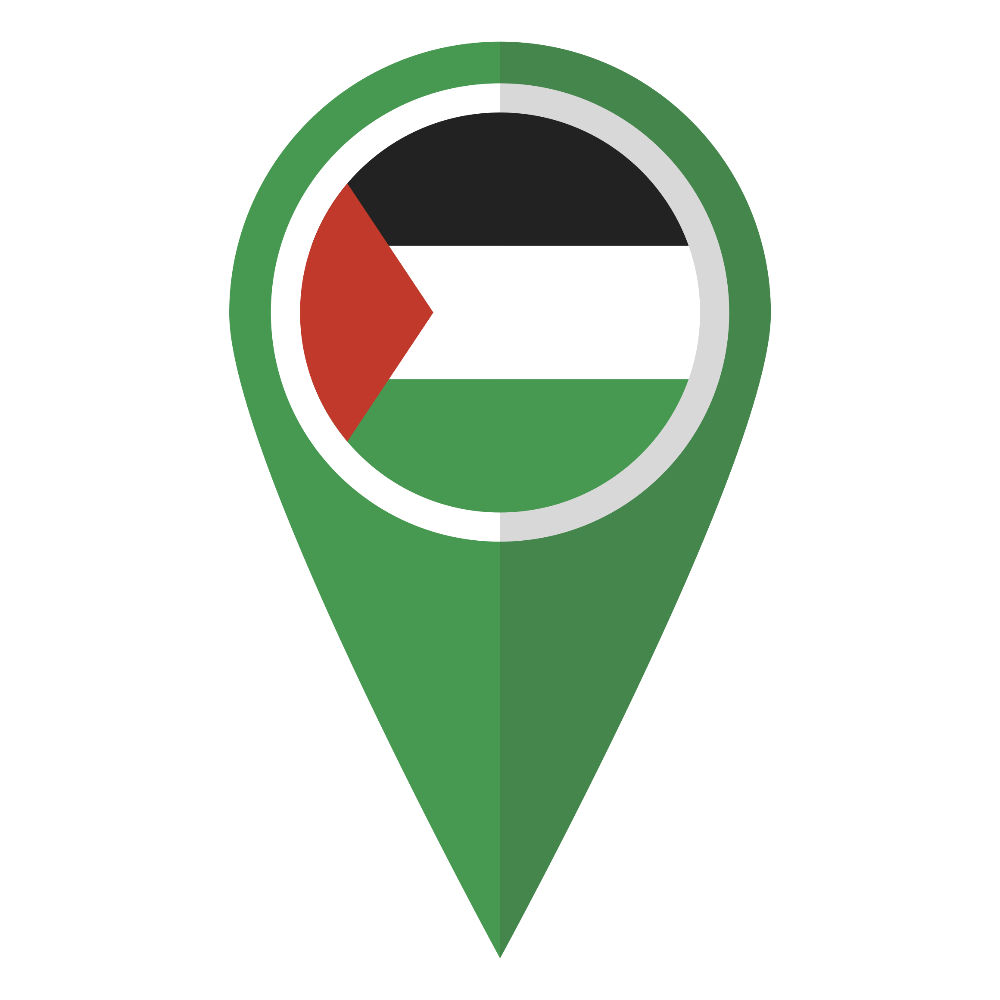

In [ ]:
# Function to create HTML for accordion
def create_accordion_content():
    accordion_content = """
    <div class="accordion" id="accordionExample">
        <div class="accordion-item">
            <h2 class="accordion-header" id="headingOne">
                <button class="accordion-button" type="button" data-bs-toggle="collapse" data-bs-target="#collapseOne" aria-expanded="true" aria-controls="collapseOne">
                    Section 1
                </button>
            </h2>
            <div id="collapseOne" class="accordion-collapse collapse show" aria-labelledby="headingOne" data-bs-parent="#accordionExample">
                <div class="accordion-body">
                    Content for Section 1
                </div>
            </div>
        </div>
        <div class="accordion-item">
            <h2 class="accordion-header" id="headingTwo">
                <button class="accordion-button collapsed" type="button" data-bs-toggle="collapse" data-bs-target="#collapseTwo" aria-expanded="false" aria-controls="collapseTwo">
                    Section 2
                </button>
            </h2>
            <div id="collapseTwo" class="accordion-collapse collapse" aria-labelledby="headingTwo" data-bs-parent="#accordionExample">
                <div class="accordion-body">
                    Content for Section 2
                </div>
            </div>
        </div>
    </div>
    """
    return accordion_content

# Create a map centered at [latitude, longitude]
map = folium.Map(location=[40.7128, -74.0060], zoom_start=12)

# Create a marker with a popup containing the dropdown accordion
popup_html = """
<!DOCTYPE html>
<html>
<head>
    <link rel="stylesheet" href="https://maxcdn.bootstrapcdn.com/bootstrap/4.5.2/css/bootstrap.min.css">
</head>
<body>
    <div>
        <h4>Marker Popup with Dropdown Accordion</h4>
        <p>Here's a dropdown accordion:</p>
        {}
    </div>
</body>
</html>
""".format(create_accordion_content())

popup = folium.Popup(IFrame(html=popup_html, width=300, height=200))

folium.Marker(
    location=[40.7128, -74.0060],
    popup=popup,
).add_to(usa_map)

# Display the map
usa_map
